# Introduction: Prediction Intervals with Scikit-Learn

In this notebook, we'll use the Gradient Boosting Regressor in Scikit-Learn to produce prediction intervals in addition to a single estimate of the target. Prediction intervals are useful when we want to show the uncertainty inherent in any prediction.

## Imports 

We're using a pretty typical data science stack plus a few visualization and interact tools for making interactive visualizations. 

In [32]:
# Data Manipulation
import pandas as pd
import numpy as np


# Modeling
from sklearn.base import BaseEstimator
from sklearn.ensemble import GradientBoostingRegressor

# File finding
import glob
files = glob.glob('data/*_energy_data.csv')

# Interactivity
from ipywidgets import interact, widgets

# Visualization
import cufflinks as cf
cf.go_offline(connected=True)
import plotly.graph_objs as go
from plotly.offline import iplot, plot, init_notebook_mode
init_notebook_mode(connected=True)

## Explore Data

For our modeling, we're going to be prediction building energy consumption. This is an important problem that we at Cortex Building Intelligence work on every day and it provides a good supervised, regression machine learning task. The energy data is measured every 15 minutes and includes 3 weather variables related to energy consumption: temperature, irradiance, and relative humidity. 

Although in a real application, we'd be using data from a database (study up on SQL), here we'll just load in the data from a csv. This is data from the DrivenData Energy Forecasting competition. You can find the original data [at DrivenData](https://www.drivendata.org/competitions/51/electricity-prediction-machine-learning/). I've cleaned up the datasets and extracted 8 features that allow us to predict the energy consumption fairly accurately. 

We're not going to spend any time on feature engineering or investigating the data, but know that should be a part of a data science pipeline.

In [2]:
data = pd.read_csv(files[2], parse_dates=['timestamp'], index_col='timestamp').sort_index()
data.head()

,energy,business_day,temperature,irradiance,relative_humidity,day_of_week,time_of_day,day_of_year,year
timestamp,,,,,,,,,
2015-01-01 05:15:00+00:00,2.18,1,6.500,0.0,60.240,3,5.25,1,2015
2015-01-01 05:30:00+00:00,2.24,1,6.501,-0.0,60.611,3,5.50,1,2015
2015-01-01 05:45:00+00:00,1.90,1,6.497,0.0,61.006,3,5.75,1,2015
2015-01-01 06:00:00+00:00,1.92,1,6.511,-0.0,61.431,3,6.00,1,2015
2015-01-01 06:15:00+00:00,1.72,1,6.443,0.0,61.301,3,6.25,1,2015


## Interactive Plot

With `ipywidgets` and `plotly` (through `cufflinks`), it's easy to create an interact plot in a few lines of code. We can take a look at the energy consumption on different timescales.

In [25]:
# Create a subset of data for plotting
data_to_plot = data.loc["2015"].copy()


def plot_timescale(timescale, selection, theme):
    """
    Plot the energy consumption on different timescales (day, week, month).
    
    :param timescale: the timescale to use
    :param selection: the numeric value of the timescale selection (for example the 15th day
    of the year or the 1st week of the year)
    :param theme: aesthetics of plot
    """
    # Subset based on timescale and selection
    subset = data_to_plot.loc[
        getattr(data_to_plot.index, timescale) == selection, "energy"
    ].copy()

    if subset.empty:
        print("Choose another selection")
        return
    
    # Make an interactive plot
    fig = subset.iplot(
            title=f"Energy for {selection} {timescale.title()}", theme=theme, asFigure=True
    )
    fig['layout']['height'] = 900
    fig['layout']['width'] = 1400
    iplot(fig)
    


_ = interact(
    plot_timescale,
    timescale=widgets.RadioButtons(
        options=["dayofyear", "week", "month"], value="dayofyear"
    ),
    # Selection 
    selection=widgets.IntSlider(value=16, min=0, max=365),
    theme=widgets.Select(options=cf.themes.THEMES.keys(), value='ggplot')
)

interactive(children=(RadioButtons(description='timescale', options=('dayofyear', 'week', 'month'), value='day…

Clearly, there are different patterns in energy usage over the course of a day, week, and month. We can also look at longer timescales.

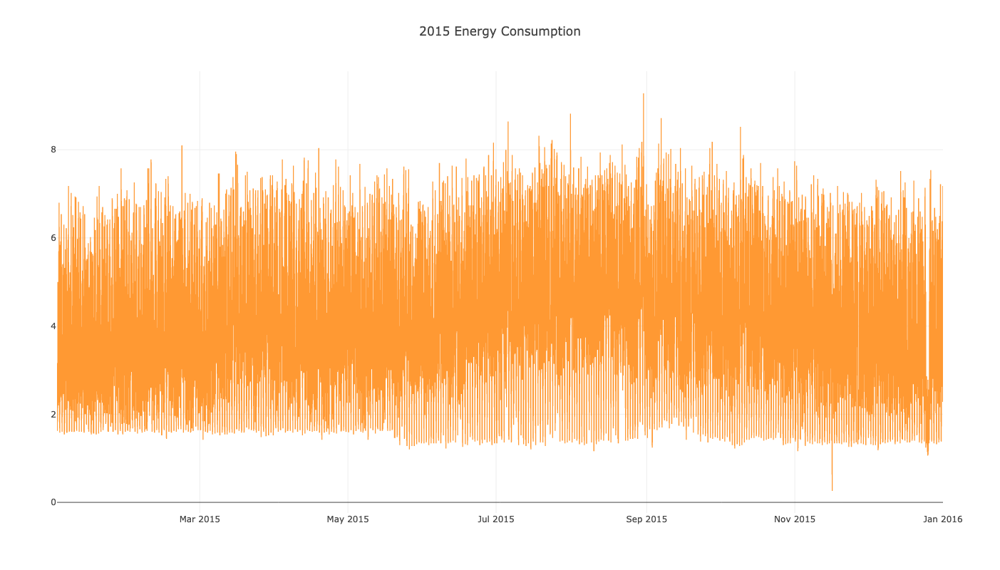

In [26]:
data.loc['2015', 'energy'].iplot(layout=dict(title='2015 Energy Consumption', height=800))

Plotting this much data can make the notebook slow. Instead, we can resample the data and plot to see any long term trends.

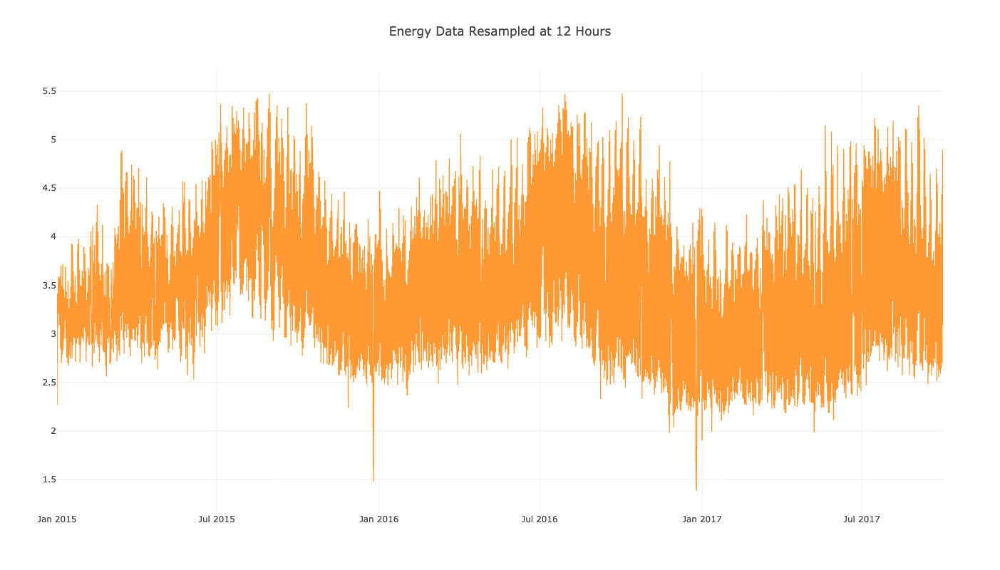

In [27]:
data.resample('12 H')['energy'].mean().iplot(layout=dict(title='Energy Data Resampled at 12 Hours', height=800))

# Predicting Intervals with the Gradient Boosting Regressor

If this was a real application, we'd problem want to spend more time understanding the data and checking for outliers. However, the main focus here is to predict intervals so let's dive into the modeling.

This code is based on an [example from Scikit-Learn](https://scikit-learn.org/stable/auto_examples/ensemble/plot_gradient_boosting_quantile.html). The basic idea is straightforward:

* For the lower prediction, use the `GradientBoostingRegressor` with `loss='quantile'` and `alpha=lower_quantile` (for example, 0.1)
* For the upper prediction, use the `GradientBoostingRegressor` with `loss='quantile'` and `alpha=upper_quantile` (for example, 0.9)
* For the middle prediction (generally taken to be the median), we have several options. We can use `GradientBoostingRegressor` with `loss='quantile'` and `alpha=0.5` or, we can use the same model with the default `loss=ls` (for least squares) which optimizes for the median.

The loss refers to the metric which is optimized by the model. We won't get into the details right here (see Quantile Loss Explained below), but for more information on the quantile loss and regression, this article is probably the best place to start: https://towardsdatascience.com/quantile-regression-from-linear-models-to-trees-to-deep-learning-af3738b527c3. [The Wikipedia page on Quantile Regression](https://en.wikipedia.org/wiki/Quantile_regression) gets into slightly more detail. For the original explanation of the Gradient Boosting model, see [Friedman's 1999 paper](https://statweb.stanford.edu/~jhf/ftp/trebst.pdf) "Greedy Function Approximation: A Gradient Boosting Machine". 

You don't need to know the details to implement the prediction intervals, although it can be useful to tuning the model. Now, let's make the predictions, and later in the notebook we'll take a high-level look at the loss function.

In [28]:
# Train and test sets
X_train = data.loc["2015":"2016"].copy()
X_test = data.loc["2017":].copy()
y_train = X_train.pop("energy")
y_test = X_test.pop("energy")

X_train.tail()
X_test.head()

,business_day,temperature,irradiance,relative_humidity,day_of_week,time_of_day,day_of_year,year
timestamp,,,,,,,,
2016-12-31 22:45:00+00:00,0,12.797,0.010,86.675,5,22.75,366,2016
2016-12-31 23:00:00+00:00,0,12.760,-0.003,86.109,5,23.00,366,2016
2016-12-31 23:15:00+00:00,0,12.633,0.001,85.309,5,23.25,366,2016
2016-12-31 23:30:00+00:00,0,12.604,-0.000,84.200,5,23.50,366,2016
2016-12-31 23:45:00+00:00,0,12.545,0.000,83.175,5,23.75,366,2016


,business_day,temperature,irradiance,relative_humidity,day_of_week,time_of_day,day_of_year,year
timestamp,,,,,,,,
2017-01-01 00:00:00+00:00,0,12.501,-0.0,82.095,6,0.00,1,2017
2017-01-01 00:15:00+00:00,0,12.446,0.0,81.159,6,0.25,1,2017
2017-01-01 00:30:00+00:00,0,12.400,-0.0,80.325,6,0.50,1,2017
2017-01-01 00:45:00+00:00,0,12.349,0.0,79.465,6,0.75,1,2017
2017-01-01 01:00:00+00:00,0,12.290,-0.0,78.649,6,1.00,1,2017


We're assuming we know all the weather in the test set, which isn't entirely realistic, but we'll use it for now!

### Build Models for Lower, Upper Quantile and Median

In [29]:
# Set lower and upper quantile
LOWER_ALPHA = 0.15
UPPER_ALPHA = 0.85

N_ESTIMATORS = 100
MAX_DEPTH = 5

# Each model has to be separate

lower_model = GradientBoostingRegressor(
    loss="quantile", alpha=LOWER_ALPHA, n_estimators=N_ESTIMATORS, max_depth=MAX_DEPTH
)
# The mid model will use the default
mid_model = GradientBoostingRegressor(loss="ls", n_estimators=N_ESTIMATORS, max_depth=MAX_DEPTH)

upper_model = GradientBoostingRegressor(
    loss="quantile", alpha=UPPER_ALPHA, n_estimators=N_ESTIMATORS, max_depth=MAX_DEPTH
)

### Train Models

The models are trained based on optimizing for the specific loss function. This means __we have to build 3 separate models to predict the different objectives.__ A downside of this method is that it's a little slow, particularly because we can't parallelize training on the Scikit-Learn Gradient Boosting Regresssor. If you wanted, you could re-write this code to train each model on a separate processor (using `multiprocessing`.)

In [30]:
_ = lower_model.fit(X_train, y_train)
_ = mid_model.fit(X_train, y_train)
_ = upper_model.fit(X_train, y_train)

### Make Predictions

With the models all trained, we now make predictions and record them with the true values.

In [33]:
predictions = pd.DataFrame(y_test)
predictions['lower'] = lower_model.predict(X_test)
predictions['mid'] = mid_model.predict(X_test)
predictions['upper'] = upper_model.predict(X_test)

predictions.tail()

,energy,lower,mid,upper
timestamp,,,,
2017-10-01 03:00:00+00:00,1.32,1.415540,2.332507,3.184027
2017-10-01 03:15:00+00:00,0.92,1.348804,2.159851,2.936441
2017-10-01 03:30:00+00:00,1.00,1.324053,1.762680,2.727110
2017-10-01 03:45:00+00:00,1.26,1.258332,1.695385,2.736437
2017-10-01 04:00:00+00:00,1.18,1.241669,1.657526,2.275236


## Prediction Intervals Plot

The best way to inspect these results is visually. Here we use plotly to make a filled area chart showing the prediction intervals.

In [69]:
def plot_intervals(predictions, start=None, stop=None, title=None):
    """
    Function for plotting prediction intervals as filled area chart.
    
    :param predictions: dataframe of predictions with lower, upper, and actual columns (named for the target)
    :param start: optional parameter for subsetting start of predictions
    :param stop: optional parameter for subsetting end of predictions
    :param title: optional string title
    
    :return fig: plotly figure
    """
    # Subset if required
    predictions = (
        predictions.loc[start:stop].copy()
        if start is not None or stop is not None
        else predictions.copy()
    )
    data = []

    # Lower trace will fill to the upper trace
    trace_low = go.Scatter(
        x=predictions.index,
        y=predictions["lower"],
        fill="tonexty",
        line=dict(color="darkblue"),
        fillcolor="lightblue",
        showlegend=True,
        name="lower",
    )
    # Upper trace has no fill
    trace_high = go.Scatter(
        x=predictions.index,
        y=predictions["upper"],
        fill=None,
        line=dict(color="orange"),
        showlegend=True,
        name="upper",
    )

    # Must append high trace first so low trace fills to the high trace
    data.append(trace_high)
    data.append(trace_low)

    # Trace of actual values
    trace_actual = go.Scatter(
        x=predictions.index,
        y=predictions["energy"],
        fill=None,
        line=dict(color="black"),
        showlegend=True,
        name="actual",
    )
    data.append(trace_actual)

    # Layout with some customization
    layout = go.Layout(
        height=900,
        width=1400,
        title=dict(text="Prediction Intervals" if title is None else title),
        yaxis=dict(title=dict(text="kWh")),
        xaxis=dict(
            rangeselector=dict(
                buttons=list(
                    [
                        dict(count=1, label="1d", step="day", stepmode="backward"),
                        dict(count=7, label="1w", step="day", stepmode="backward"),
                        dict(count=1, label="1m", step="month", stepmode="backward"),
                        dict(count=1, label="YTD", step="year", stepmode="todate"),
                        dict(count=1, label="1y", step="year", stepmode="backward"),
                        dict(step="all"),
                    ]
                )
            ),
            rangeslider=dict(visible=True),
            type="date",
        ),
    )

    fig = go.Figure(data=data, layout=layout)

    # Make sure font is readable
    fig["layout"]["font"] = dict(size=20)
    fig.layout.template = "plotly_white"
    return fig


# Example plot subsetted to one week
fig = plot_intervals(predictions, start="2017-03-01", stop="2017-03-08")

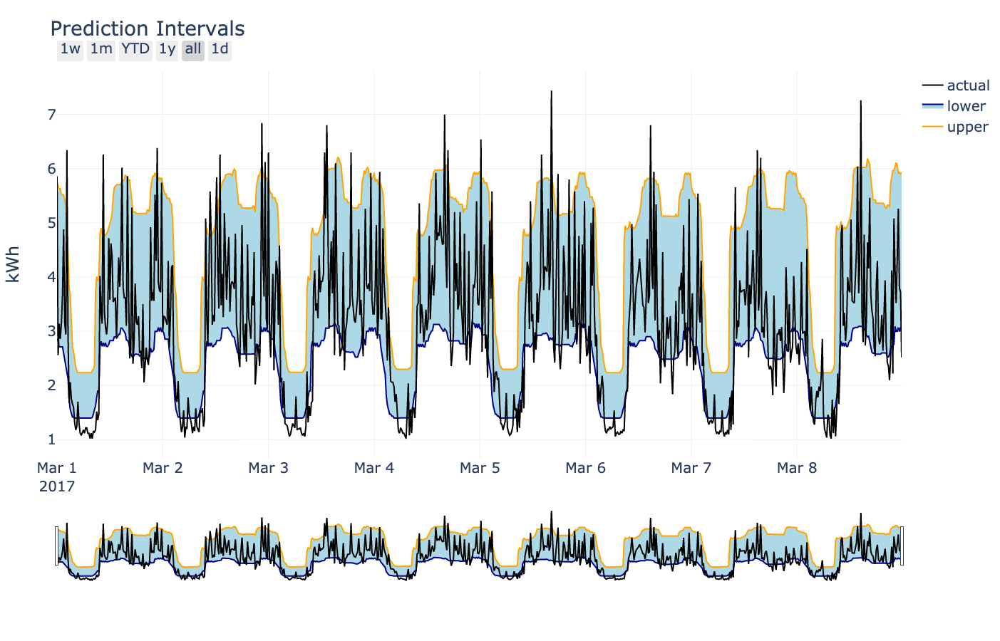

In [63]:
iplot(fig)

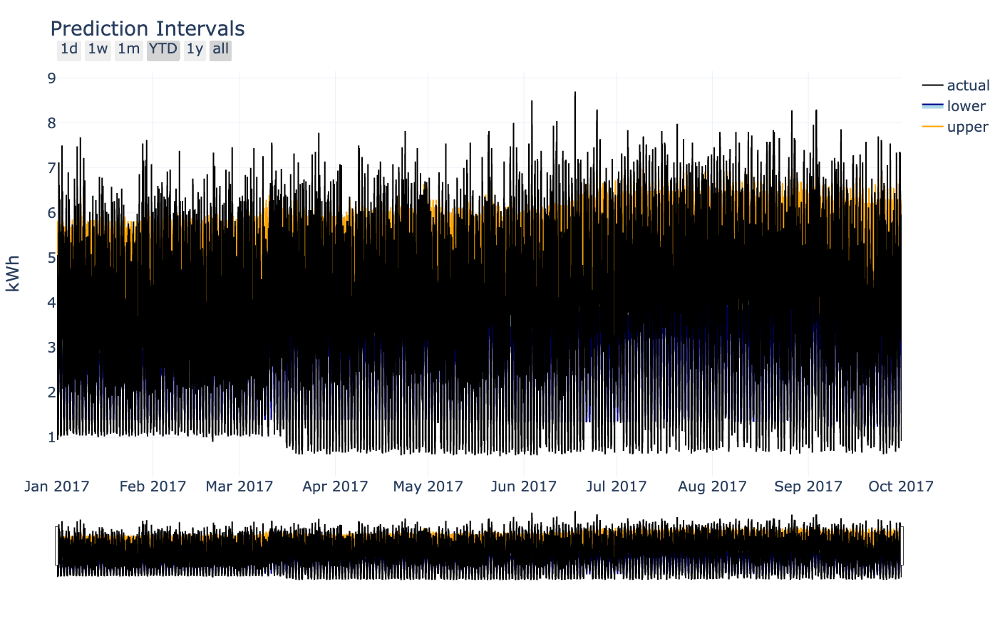

In [56]:
iplot(plot_intervals(predictions))

Not too bad for a first try! Play around with the model parameters and the `alpha` parameters to see how it affects the plot.

### Calculate Error

With any machine learning model, we want to make predictions of the error. Quantifying the error of a prediction range can be tricky. We'll start off with the percentage of the time that the actual value falls in the range. However, one way to maximize this metric would be to just use extremely wide prediction intervals. Therefore, we want to penalize the model for making too wide prediction intervals. As a simple example (let me know ideas for a better metric) we can calculate the absolute error of the bottom and top lines, and divide by two to get an absolute error. We then take the average for the mean absolute error. We can also calculate the absolute error of the mid predictions.

These are likely not the best metrics for all cases, so think about what your objective is before selecting a metric. For instance, you may want wide prediction intervals in which case you value the percent in bounds more than the error, but other times, you might want a narrow range of estimates.

In [67]:
def calculate_error(predictions):
    """
    Calculate the absolute error associated with prediction intervals
    
    :param predictions: dataframe of predictions
    :return: None, modifies the prediction dataframe
    
    """
    
    predictions['absolute_error_lower'] = (predictions['lower'] - predictions['energy']).abs()
    predictions['absolute_error_upper'] = (predictions['upper'] - predictions['energy']).abs()
    
    predictions['absolute_error_interval'] = (predictions['absolute_error_lower'] + predictions['absolute_error_upper']) / 2
    predictions['absolute_error_mid'] = (predictions['mid'] - predictions['energy']).abs()
    
    predictions['in_bounds'] = predictions['energy'].between(left=predictions['lower'], right=predictions['upper'])

In [68]:
calculate_error(predictions)
metrics = predictions[['absolute_error_lower', 'absolute_error_upper', 'absolute_error_interval', 'absolute_error_mid', 'in_bounds']].copy()
metrics.describe()

,absolute_error_lower,absolute_error_upper,absolute_error_interval,absolute_error_mid
count,26225.000000,26225.000000,26225.000000,26225.000000
mean,0.956337,1.664739,1.310538,0.852132
std,0.900436,0.892989,0.414051,0.591601
min,0.000011,0.000033,0.329497,0.000149
25%,0.280664,1.010932,1.085340,0.394133
50%,0.644965,1.593469,1.355695,0.751974
75%,1.359295,2.293704,1.489732,1.190293
max,5.316833,4.552278,3.837559,3.835088


In [ ]:
import plotly_express as px
px.bar(metrics.melt(var_name='metric'), x='metric', y='value', title='Error Metrics Boxplots', height=800, width=1600)

# Prediction Interval Class

To make this process repeatable, we can build our own estimator with a Scikit-Learn interface that fits and predicts all 3 models in one call each. This is a very simple class but can be extended based on your needs (feel free to show me ways to improve).

In [57]:
class GradientBoostingPredictionIntervals(BaseEstimator):
    """
    Model that produces prediction intervals with a Scikit-Learn inteface
    
    :param lower_alpha: lower quantile for prediction, default=0.1
    :param upper_alpha: upper quantile for prediction, default=0.9
    :param **kwargs: additional keyword arguments for creating a GradientBoostingRegressor model
    """

    def __init__(self, lower_alpha=0.1, upper_alpha=0.9, **kwargs):
        self.lower_alpha = lower_alpha
        self.upper_alpha = upper_alpha

        # Three separate models
        self.lower_model = GradientBoostingRegressor(
            loss="quantile", alpha=self.lower_alpha, **kwargs
        )
        self.mid_model = GradientBoostingRegressor(loss="ls", **kwargs)
        self.upper_model = GradientBoostingRegressor(
            loss="quantile", alpha=self.upper_alpha, **kwargs
        )
        self.predictions = None

    def fit(self, X, y):
        """
        Fit all three models
            
        :param X: train features
        :param y: train targets
        
        TODO: parallelize this code across processors
        """
        self.lower_model.fit(X_train, y_train)
        self.mid_model.fit(X_train, y_train)
        self.upper_model.fit(X_train, y_train)

    def predict(self, X, y):
        """
        Predict with all 3 models 
        
        :param X: test features
        :param y: test targets
        :return predictions: dataframe of predictions
        
        TODO: parallelize this code across processors
        """
        predictions = pd.DataFrame(y)
        predictions["lower"] = self.lower_model.predict(X)
        predictions["mid"] = self.mid_model.predict(X)
        predictions["upper"] = self.upper_model.predict(X)
        self.predictions = predictions

        return predictions

    def plot_intervals(self, start=None, stop=None):
        """
        Plot the prediction intervals
        
        :param start: optional parameter for subsetting start of predictions
        :param stop: optional parameter for subsetting end of predictions
    
        :return fig: plotly figure
        """

        if self.predictions is None:
            raise ValueError("This model has not yet made predictions.")
            return

        # Subset if required
        predictions = (
            self.predictions.loc[start:stop].copy()
            if start is not None or stop is not None
            else self.predictions.copy()
        )
        fig = plot_intervals(predictions)
        return fig

To use the model, we just fit and predict like any Scikit-Learn model. This time though, the predictions are a dataframe with intervals.

In [58]:
model = GradientBoostingPredictionIntervals(lower_alpha=0.1, upper_alpha=0.9, n_estimators=50, max_depth=3)

# Fit and make predictions
_ = model.fit(X_train, y_train)
predictions = model.predict(X_test, y_test)

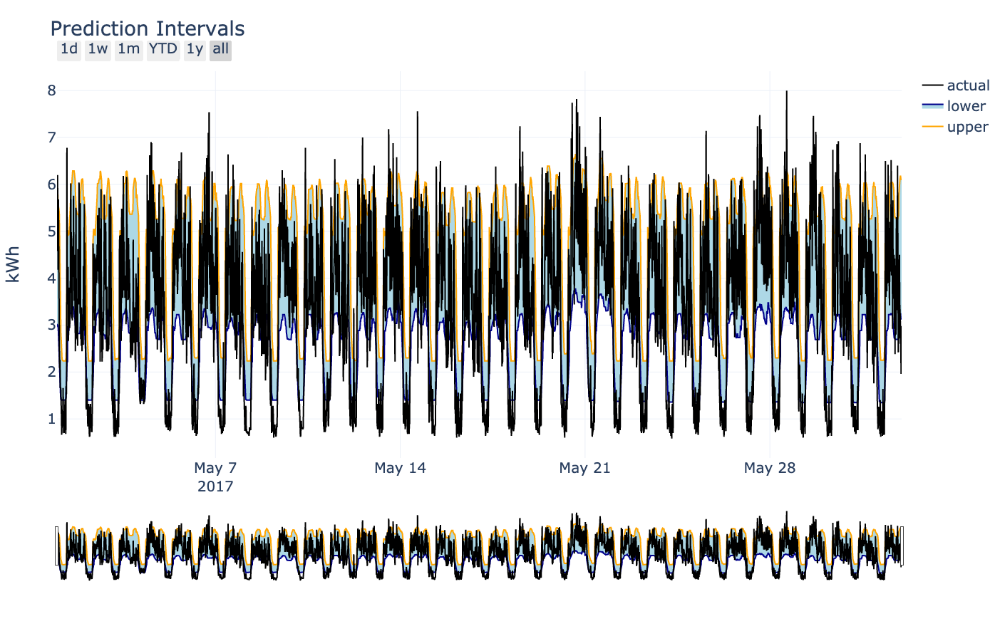

In [59]:
fig = model.plot_intervals(start='2017-05-01', 
                           stop='2017-06-01')
iplot(fig)